### Data Preprocesging
Here we will preprocess the data to make it ready for regression models. This script includes RT and acc based preprocessing. as well as one point, refers to manual mouse trajectory preprocessing. Afterwards, we then plot several graphs to visualize the data.

In [1]:
import pandas as pd
import glob
import matplotlib.pyplot as plt
from scipy.stats import f_oneway
from statsmodels.stats.multicomp import pairwise_tukeyhsd
import seaborn as sns
import math
import statistics
import warnings
import numpy as  np
import ast
import re
from scipy.signal import resample
import tkinter as tk
from matplotlib.backends.backend_tkagg import FigureCanvasTkAgg
warnings.filterwarnings('ignore')

df = pd.read_json(r"C:\Users\veoni\Documents\GitHub\MTE_DLAB\Squircle experiment\DF_clean.json")
df = df[(df['block_number'] != 'Training')]
df_acc = df[(df['difficulty'] != 'Control') & (df['acc'] != 'Control') & (df['acc'] != 'NAN')]

# Convert 'acc' column to 1 for True and 0 for False
df_acc['acc'] = df_acc['acc'].astype(int)
df = df.drop('Unnamed: 0', axis=1, errors='ignore')
#shortened df
df_comp = df[['pt_num','trial_nbr','block_number', 'acc', 'choice', 'true_value', 'difficulty', 'rt', 'previous_response', 'downsampled_traj', 'timestamps']].copy()

In [2]:
# Calculate average accuracy and reaction time by difficulty level
avg_stats = df_acc.groupby(['difficulty', 'true_value'] ).agg({'acc': 'mean', 'rt': 'mean'}).reset_index()
print(avg_stats)

  difficulty true_value       acc        rt
0       Easy       Blue  0.864674  0.460808
1       Easy        Red  0.841806  0.467413
2       Hard       Blue  0.715600  0.480877
3       Hard        Red  0.667774  0.493310
4     Medium       Blue  0.785950  0.471630
5     Medium        Red  0.752135  0.478263


### Preprocessing

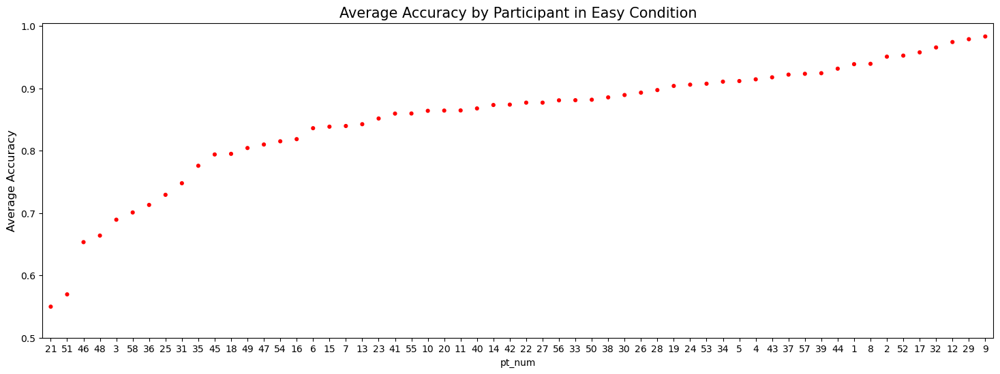

In [3]:
# Calculate the average accuracy per participant and plotting the results
avg_stats_pt = df_acc.groupby(['pt_num', 'difficulty']).agg({'acc': 'mean'}).reset_index()
avg_stats_pt_easy = avg_stats_pt[avg_stats_pt['difficulty'] == 'Easy']
avg_stats_pt_easy_sorted = avg_stats_pt_easy.sort_values('acc', ascending=True)

# Plotting the results
# Add pt_num numbers next to the points

# Plotting the results
plt.figure(figsize=(18, 6))  # Increase the size of the figure

ax = sns.pointplot(data=avg_stats_pt_easy_sorted, x='pt_num', y='acc', color='red', order=avg_stats_pt_easy_sorted['pt_num'], join=False, scale=0.5)
ax.set_title('Average Accuracy by Participant in Easy Condition', fontsize=15)  # Add the title
# Adjust the font size of y-axis labels
ax.set_ylabel('Average Accuracy', fontsize=12)
ax.set_yticks([0.5, 0.6, 0.7, 0.8, 0.9, 1.0])  # Set the y-axis range



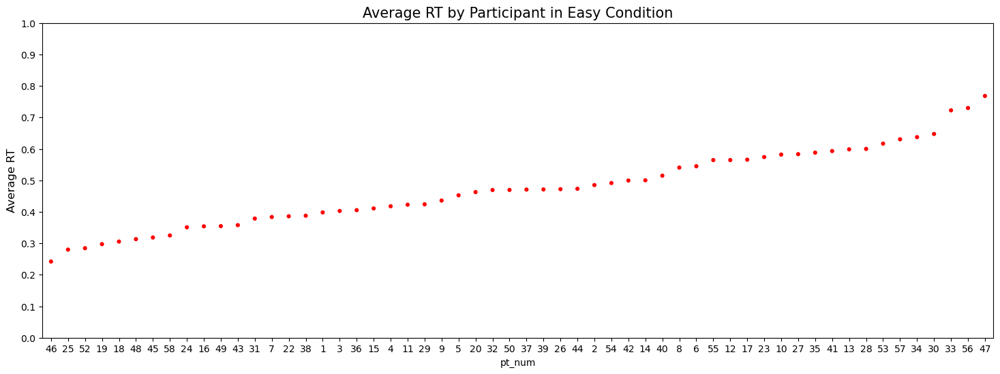

In [4]:
#Removing partcipants 21 and 51
# Doing the same procedure for RT.
df_filtered = df_comp[(df_comp['pt_num'] != 21) & (df_comp['pt_num'] != 51)]

avg_stats_rt = df_filtered.groupby(['pt_num', 'difficulty']).agg({'rt': 'mean'}).reset_index()
avg_stats_rt_easy = avg_stats_rt[avg_stats_rt['difficulty'] == 'Easy']
avg_stats_rt_easy_sorted = avg_stats_rt_easy.sort_values('rt', ascending=True)
plt.figure(figsize=(18, 6))  # Increase the size of the figure

ax = sns.pointplot(data=avg_stats_rt_easy_sorted, x='pt_num', y='rt', color='red', order=avg_stats_rt_easy_sorted['pt_num'], join=False, scale=0.5)
ax.set_title('Average RT by Participant in Easy Condition', fontsize=15)  # Add the title
# Adjust the font size of y-axis labels
ax.set_ylabel('Average RT', fontsize=12)
ax.set_yticks([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0])  # Set the y-axis range

0.101161609


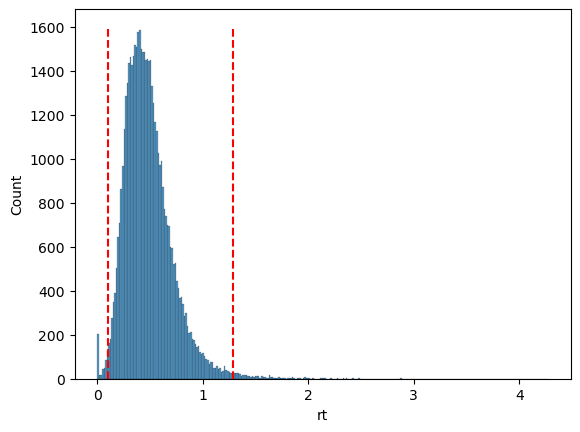

In [5]:
#Participant based Rts does not show striking differences between participants.
# We do quantile based rejection to cope with the outliers.
# Quantile based plotting
q1 = df_filtered['rt'].quantile(0.99)
q2 = df_filtered['rt'].quantile(0.01)
print(q2)
sns.histplot(data=df_filtered, x='rt')
plt.vlines(q1, 0, 1600, color='red', linestyle='--')
plt.vlines(q2, 0, 1600, color='red', linestyle='--')

<Axes: xlabel='rt', ylabel='Count'>

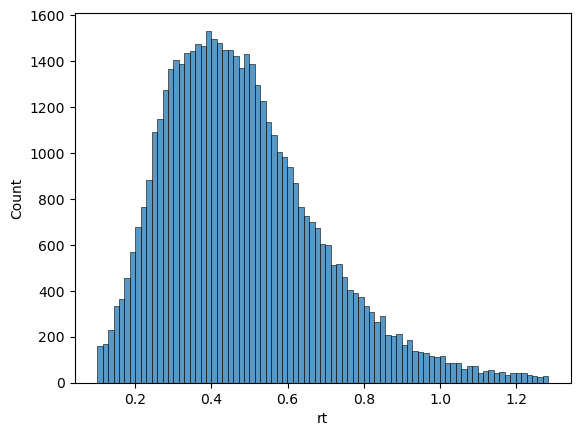

In [6]:
# Filtering the data q1 around 100ms and q2 around 2sec
df_filtered = df_filtered[(df_filtered['rt'] >= q2) & (df_filtered['rt'] <= q1)]
# Next we plot the data again to see if the outliers are removed
sns.histplot(data=df_filtered, x='rt')


### Manual Preprocessing (Optional)
Here we plot all the trials and check whether it is inline with our acceptance criteria. We can see that there are some trials which are not inline with our acceptance criteria. We can remove these trials from our dataset. You can find the specific script for '3.1_Manual Preprocessing (Optional)'.

### Big plot

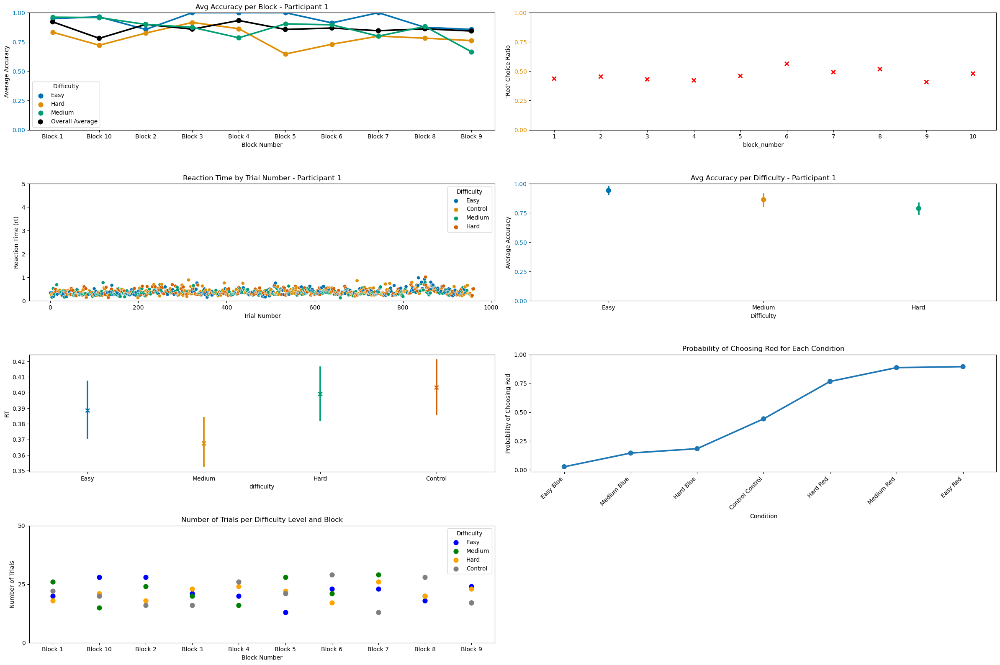

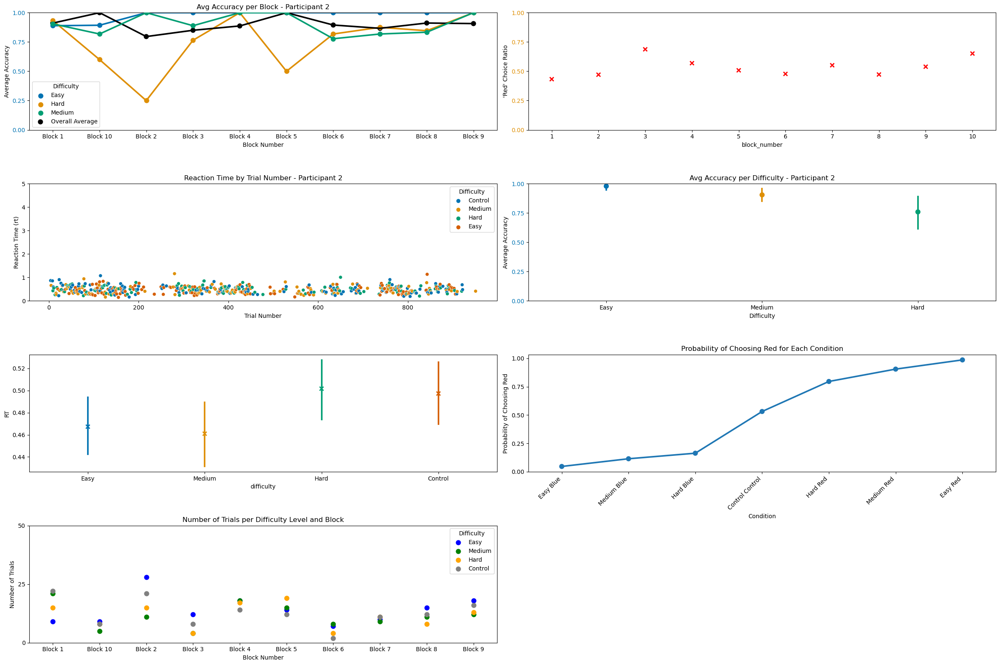

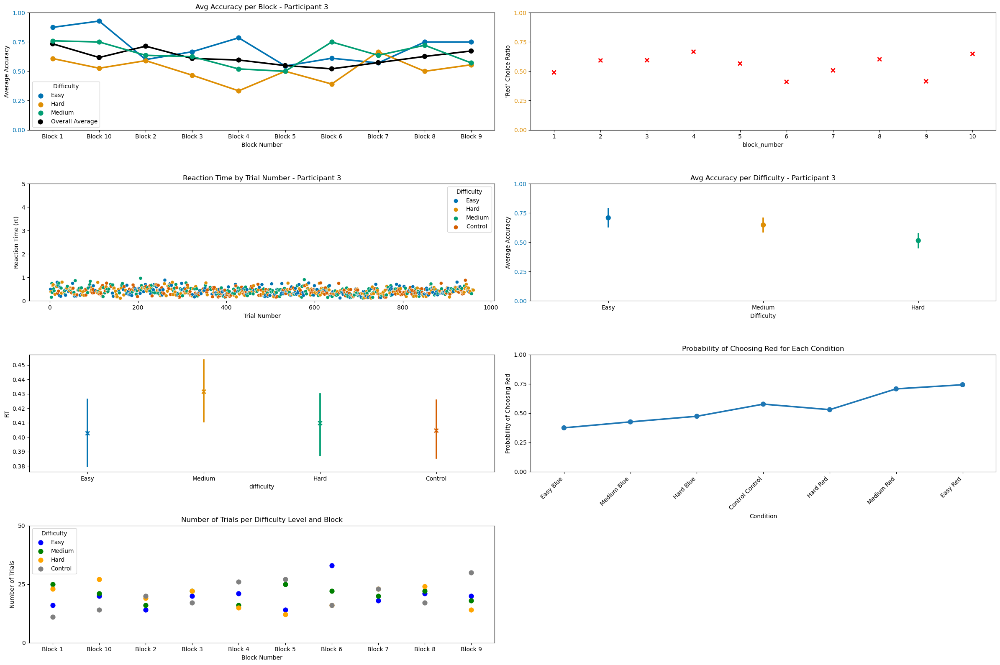

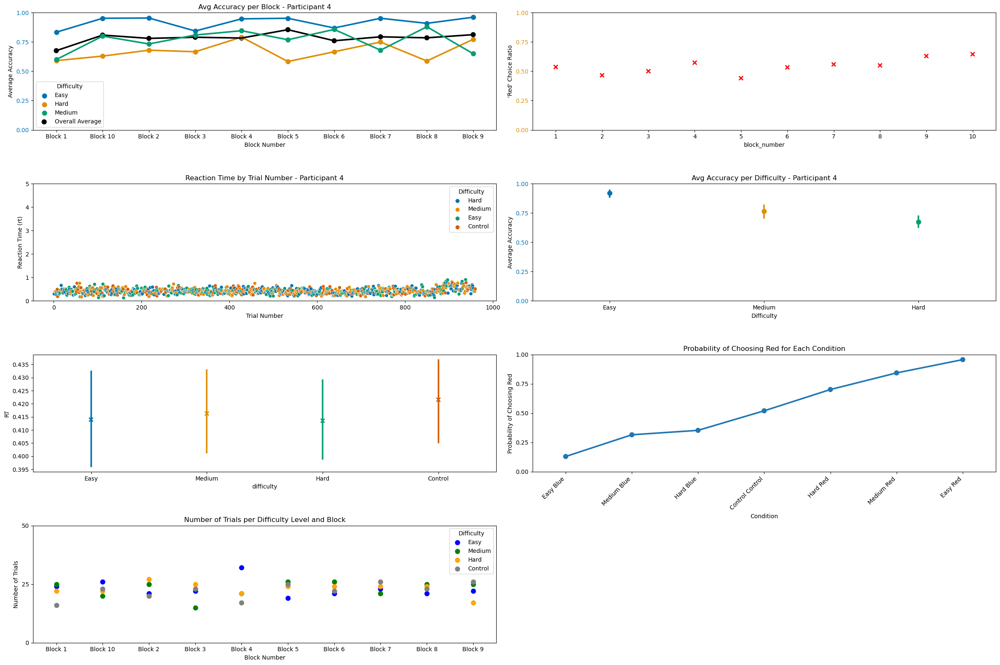

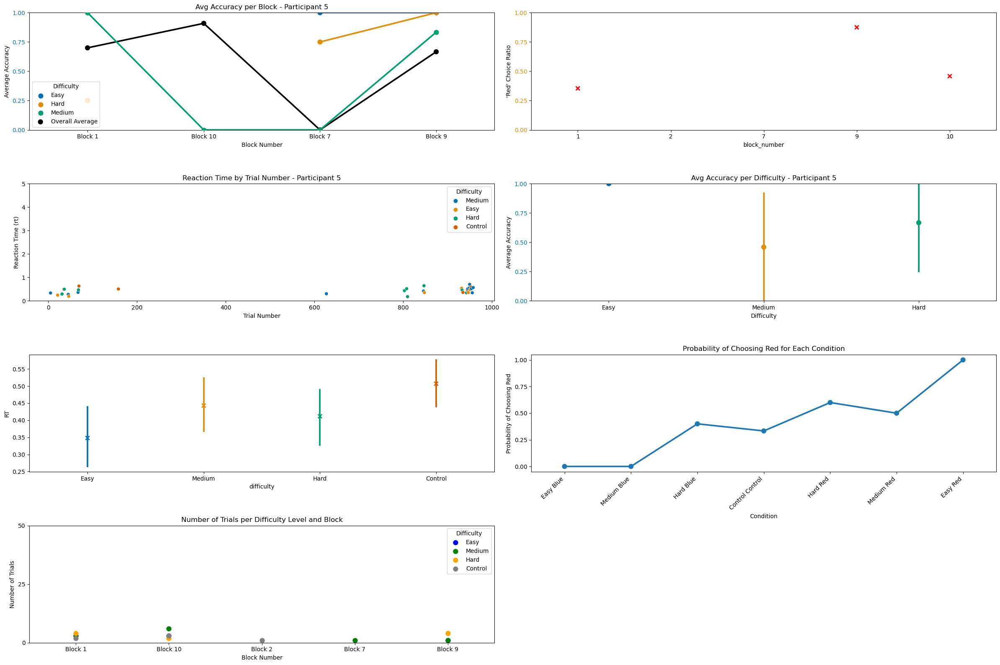

...

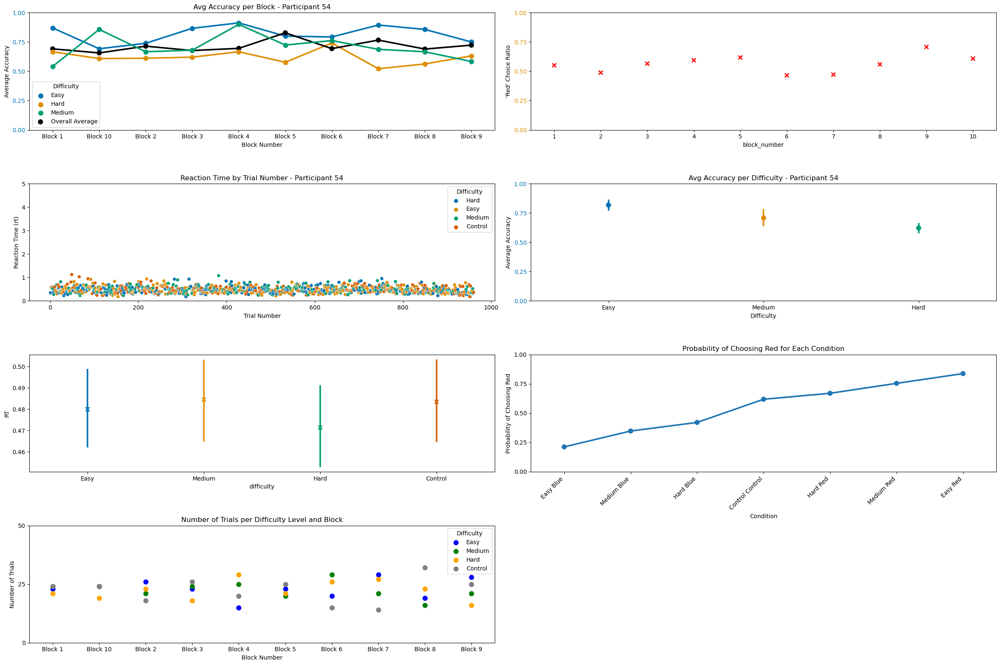

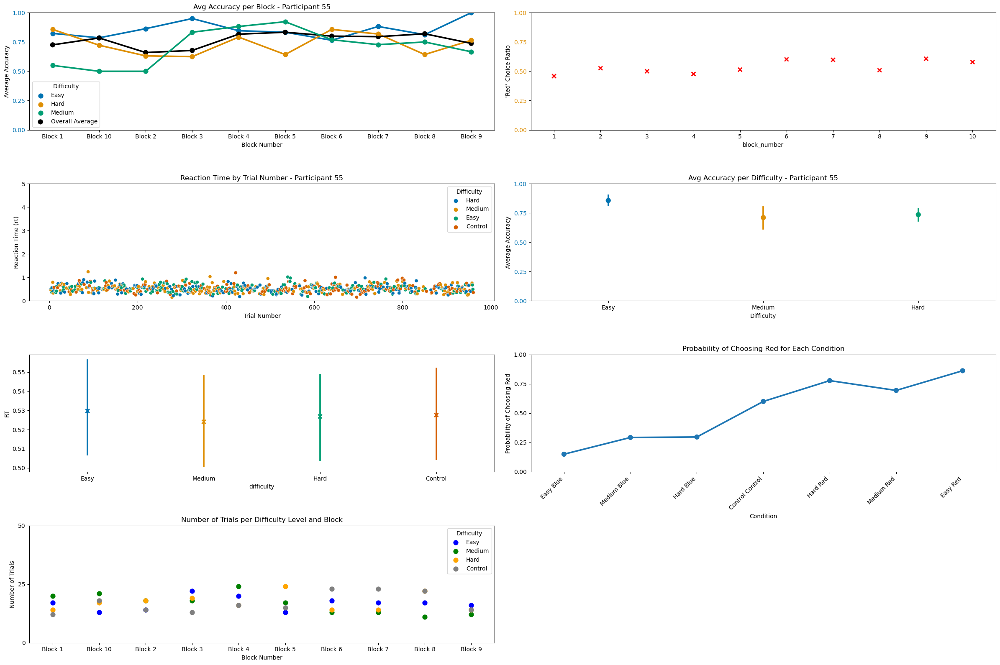

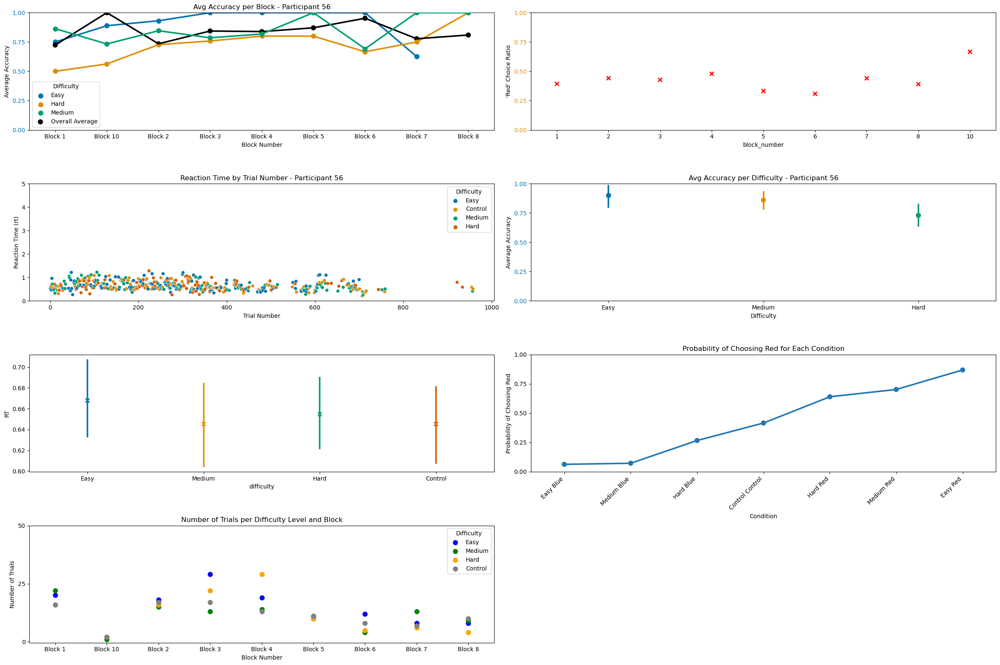

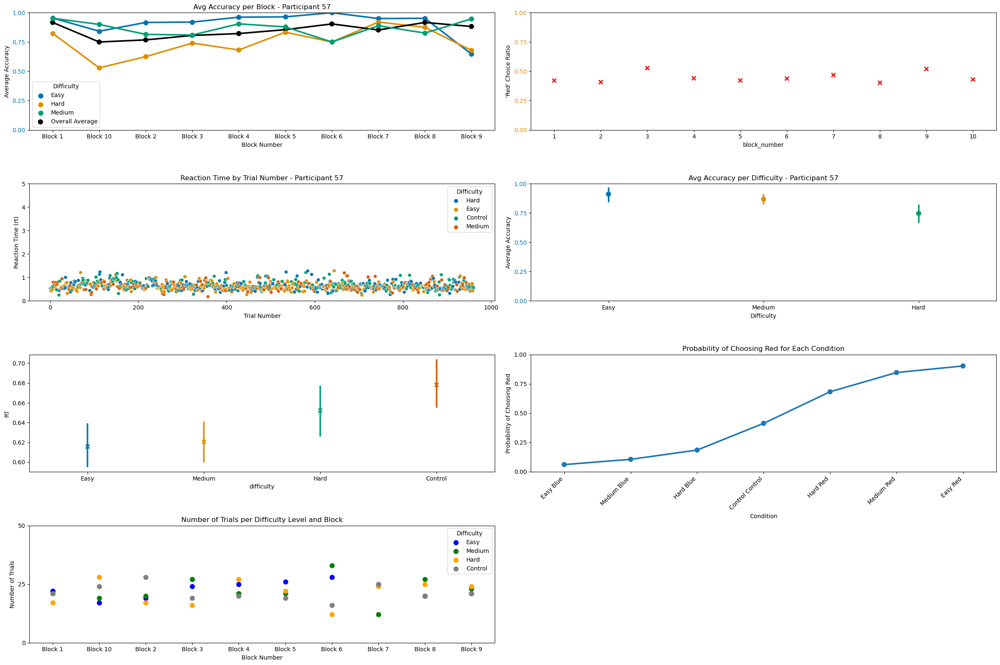

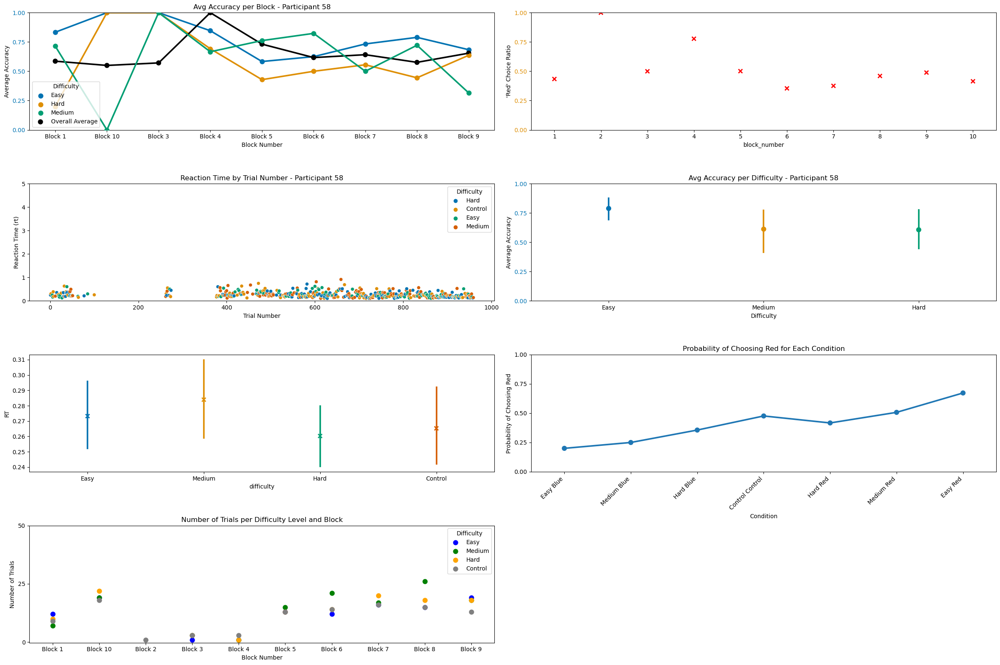

In [7]:
df_comp = pd.read_json(r"C:\Users\veoni\Documents\GitHub\MTE_DLAB\Analysis\DF_manrev.json")
# Set the style of seaborn
sns.axes_style()
# Define a color-blind friendly palette with distinct patterns for Easy, Medium, Hard, and Control
palette = sns.color_palette("colorblind", 4)

# Specify the order of difficulty conditions excluding 'Control'
difficulty_order_acc = ['Easy', 'Medium', 'Hard']

# Conditions for the new plot
conditions = [('Easy', 'Blue'),
              ('Medium', 'Blue'),
              ('Hard', 'Blue'),
              ('Control', 'Control'),
              ('Hard', 'Red'),
              ('Medium', 'Red'),
              ('Easy', 'Red')]

# Get unique participant numbers from the DataFrame and sort them
participant_numbers = sorted(df_comp['pt_num'].unique())

# Loop through each participant
for i, participant_num in enumerate(participant_numbers):
    sns.axes_style()
    # Filter the DataFrame for the current participant
    participant_data = df_comp[df_comp['pt_num'] == participant_num]

    # Calculate the average accuracy and 'Red' choice ratio per block for the current participant
    avg_accuracy_per_block = (participant_data[participant_data['difficulty'] != 'Control']
                              .groupby(['block_number', 'difficulty'])['acc']
                              .mean()
                              .reset_index())

    red_choice_ratio_per_block = (participant_data[participant_data['choice'] == 'Red']
                                  .groupby(['block_number', 'difficulty'])['choice']
                                  .count() / participant_data.groupby(['block_number', 'difficulty'])['choice'].count()).reset_index()

    # Extract and sort the numeric part of block numbers
    avg_accuracy_per_block['block_number'] = avg_accuracy_per_block['block_number'].apply(lambda x: int(re.search(r'\d+', x).group()))
    red_choice_ratio_per_block['block_number'] = red_choice_ratio_per_block['block_number'].apply(lambda x: int(re.search(r'\d+', x).group()))

    # Sort the DataFrame by block number and difficulty
    avg_accuracy_per_block = avg_accuracy_per_block.sort_values(by=['block_number', 'difficulty'])
    red_choice_ratio_per_block = red_choice_ratio_per_block.sort_values(by=['block_number', 'difficulty'])

    # Plot 0: Average Accuracy per Block
    fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(24, 16))

    sns.pointplot(x="block_number", y="acc", hue="difficulty", data=avg_accuracy_per_block, palette=palette, markers="o", linestyles="-", ax=axs[0, 0], join=True)
    overall_avg_accuracy = (participant_data[participant_data['difficulty'] != 'Control'].groupby('block_number')['acc'].mean().reset_index())
    sns.pointplot(x="block_number", y="acc", data=overall_avg_accuracy, color='black', ax=axs[0, 0], label='Overall Average')
    axs[0, 0].set_xlabel("Block Number")
    axs[0, 0].set_ylabel("Average Accuracy")
    axs[0, 0].set_yticks([0,0.25,0.50,0.75,1.0])
    axs[0, 0].set_ylim(0, 1)  # Assuming accuracy values are between 0 and 1
    axs[0, 0].tick_params(axis='y', labelcolor=palette[0])
    axs[0, 0].set_title(f"Avg Accuracy per Block - Participant {participant_num}")
    axs[0, 0].legend(title='Difficulty', loc='lower left')

    # Plot 1: 'Red' Choice Ratio per Block
    ax2 = axs[0, 1]
    sns.pointplot(x="block_number", y="choice", data=red_choice_ratio_per_block, color='red', ci=None, markers="x", linestyles="--", ax=ax2, join=False)
    ax2.set_ylabel("'Red' Choice Ratio")
    ax2.set_yticks([0,0.25,0.50,0.75,1.0])
    ax2.set_ylim(0, 1)  # Assuming choice ratio values are between 0 and 1
    ax2.tick_params(axis='y', labelcolor=palette[1])

    # Plot 2: Reaction Time by Trial Number
    sns.scatterplot(x="trial_nbr", y="rt", hue="difficulty", data=participant_data, palette=palette, markers="x", linestyles="-", ax=axs[1, 0])
    axs[1, 0].set_xlabel("Trial Number")
    axs[1, 0].set_ylabel("Reaction Time (rt)")
    axs[1, 0].set_ylim(0, 5)
    axs[1, 0].set_title(f"Reaction Time by Trial Number - Participant {participant_num}")

    # Add a legend for the difficulty conditions
    axs[1, 0].legend(title='Difficulty', loc='upper right')

    # Plot 3: Average Accuracy per Difficulty (excluding 'Control')
    sns.pointplot(x="difficulty", y="acc", data=avg_accuracy_per_block, palette=palette[:-1], order = ['Easy', 'Medium', 'Hard'], markers="o", linestyles="-", ax=axs[1, 1], join=True)
    axs[1, 1].set_xlabel("Difficulty")
    axs[1, 1].set_ylabel("Average Accuracy")
    axs[1, 1].set_yticks([0,0.25,0.50,0.75,1.0])
    axs[1, 1].set_ylim(0, 1)  # Assuming accuracy values are between 0 and 1
    axs[1, 1].tick_params(axis='y', labelcolor=palette[0])
    axs[1, 1].set_title(f"Avg Accuracy per Difficulty - Participant {participant_num}")

    
    #sns.set_style("whitegrid", {"grid.color": ".001", "grid.linestyle": ":"})
    # Plot 4: Reaction Time per Difficulty (including 'Control')
    sns.pointplot(x="difficulty", y="rt", data=participant_data, palette=palette, markers="x",order = ['Easy', 'Medium', 'Hard', 'Control'], linestyles="-", ax=axs[2, 0])
    axs[2,0].set_ylabel('RT')
    
    # Plot 5: Probability of Choosing Red for Each Condition
    #sns.set_style("whitegrid", {"grid.color": ".001", "grid.linestyle": ":"})
    ax5 = axs[2, 1]  # Twin Axes for the new plot
    subset_data_list = []

    for j, (difficulty, true_color) in enumerate(conditions, 1):
        subset_data = participant_data[(participant_data['difficulty'] == difficulty) & (participant_data['true_value'] == true_color)]
        probabilities = subset_data['choice'].value_counts(normalize=True).get('Red', 0)

        subset_data_list.append({'Condition': f'{difficulty} {true_color}', 'Probability of Red': probabilities})

    # Create a DataFrame from the list
    plot_data = pd.DataFrame(subset_data_list)

    # Plotting using sns.pointplot
    sns.pointplot(x='Condition', y='Probability of Red', data=plot_data, order=[f'{c[0]} {c[1]}' for c in conditions], ax=ax5)
    ax5.set_xticklabels(ax5.get_xticklabels(), rotation=45, ha='right')  # Rotate x-axis labels for better visibility
    ax5.set_title('Probability of Choosing Red for Each Condition')
    ax5.set_xlabel('Condition')
    ax5.set_yticks([0,0.25,0.50,0.75,1.0])
    ax5.set_ylabel('Probability of Choosing Red')
    
    #Plot-6
    #sns.set_style("whitegrid", {"grid.color": ".001", "grid.linestyle": ""})
        # Filter data for each difficulty level
    easy_data = participant_data[participant_data['difficulty'] == 'Easy']
    medium_data = participant_data[participant_data['difficulty'] == 'Medium']
    hard_data = participant_data[participant_data['difficulty'] == 'Hard']
    control_data = participant_data[participant_data['difficulty'] == 'Control']
    
    # Group data by block number and count the number of trials
    easy_counts = easy_data['block_number'].value_counts().sort_index()
    medium_counts = medium_data['block_number'].value_counts().sort_index()
    hard_counts = hard_data['block_number'].value_counts().sort_index()
    control_counts = control_data['block_number'].value_counts().sort_index()
    df_counts = pd.DataFrame({
    'Easy': easy_counts,
    'Medium': medium_counts,
    'Hard': hard_counts,
    'Control': control_counts})
    df_counts_reset = df_counts.reset_index()
    sns.pointplot(data=df_counts_reset.melt(id_vars='block_number', var_name='Difficulty', value_name='Number of Trials'),
              x='block_number', y='Number of Trials', hue='Difficulty',
              palette=['blue', 'green', 'orange', 'gray'], markers='o', linestyles='-',join = False, ax=axs[3,0])
    # Set labels and title
    axs[3,0].set_xlabel("Block Number")
    axs[3,0].set_ylabel("Number of Trials")
    axs[3,0].set_title("Number of Trials per Difficulty Level and Block")
    axs[3,0].set_yticks([0,25,50])
    # Adjust layout
    axs[3,1].remove()
    plt.tight_layout()
    plt.show()
    # Save the figure to a PDF file
    plt.savefig(f'../Figures/pt_plots/participant_{participant_num}_gen_plot.pdf')
    
    # Show the plot
    # Close the figure to free up resources
    plt.close()

### Conclusion

Here we can see that the data is ready for regression models. We can now move on to the next step of our analysis.
In the next stage we will apply an algorithm to sort out the length of mouse trajectory.
With this we will be able to plot the averaged mouse trajectories without losing the temporal precision of the data.